### panda est construit sur la base de Numpy
### panda permet aussi de travailler en collaboration avec matplotlib

In [11]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# pour le lire le fichier excel
pd.read_excel('titanic3.xls')

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,29.0000,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.9167,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,2.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,30.0000,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,25.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1304,3,0,"Zabour, Miss. Hileni",female,14.5000,1,0,2665,14.4542,NaN,C,NaN,328.0,NaN
1305,3,0,"Zabour, Miss. Thamine",female,NaN,1,0,2665,14.4542,NaN,C,NaN,NaN,NaN
1306,3,0,"Zakarian, Mr. Mapriededer",male,26.5000,0,0,2656,7.2250,NaN,C,NaN,304.0,NaN
1307,3,0,"Zakarian, Mr. Ortin",male,27.0000,0,0,2670,7.2250,NaN,C,NaN,NaN,NaN


In [12]:
data = pd.read_excel('titanic3.xls')

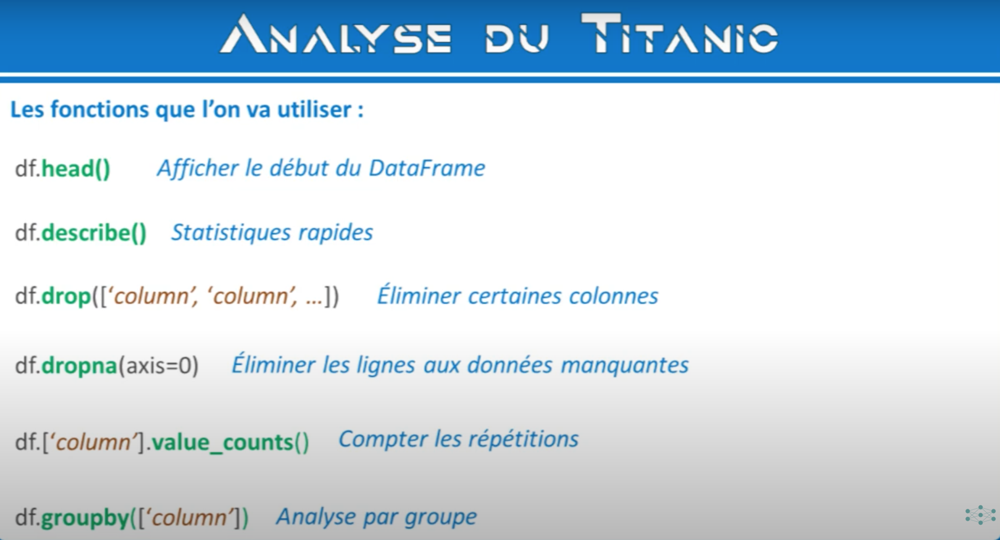

In [13]:
data.shape
# voir le header du data avec les premières infos
data.head()

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,29.0000,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.9167,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,2.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,30.0000,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,25.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"


In [14]:
# éliminer des colonnes avec le nom du premier élément et drop:
newData=data.drop(['name', 'sibsp', 'parch', 'ticket', 'fare',
                   'cabin' ,'embarked', 'boat', 'body', 'home.dest'], axis=1)
newData.head()

,pclass,survived,sex,age
0,1,1,female,29.0000
1,1,1,male,0.9167
2,1,0,female,2.0000
3,1,0,male,30.0000
4,1,0,female,25.0000


In [15]:
# produit les statistiques de base pour chacune des colonnes
newData.describe()
# count = nbr de lignes
# mean = moyenne
# std = racinne carré
# min = minimum

,pclass,survived,age
count,1309.000000,1309.000000,1046.000000
mean,2.294882,0.381971,29.881135
std,0.837836,0.486055,14.413500
min,1.000000,0.000000,0.166700
25%,2.000000,0.000000,21.000000
50%,3.000000,0.000000,28.000000
75%,3.000000,1.000000,39.000000
max,3.000000,1.000000,80.000000


In [16]:
# on voit qu'il nous manque des données dnas la colonne age

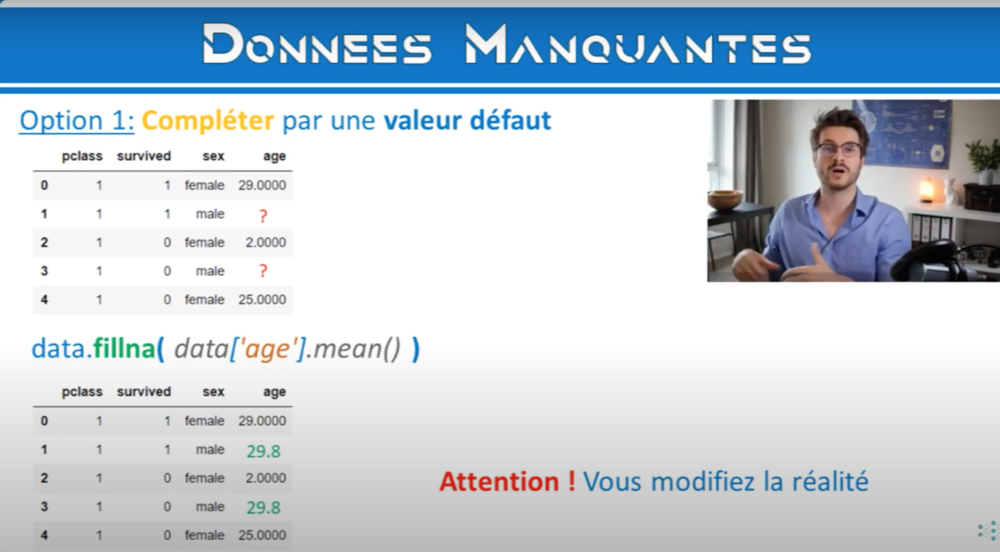

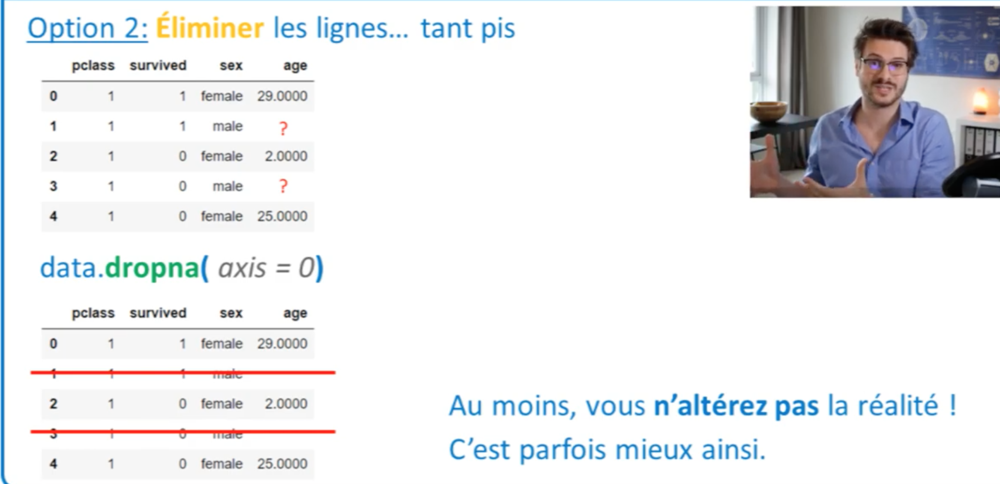

In [17]:
# du coup on va opter pour la deuxième option
# supprimer les lignes où je n'ai pas de données pour toutes mes colonnes
newDataFluent = newData.dropna(axis=0)

In [18]:
# en printant la shape on voit que notre matrice n'a plus la même forme
newDataFluent.shape

(1046, 4)

In [23]:
print(newDataFluent.describe())
print(newDataFluent.head())

            pclass     survived          age
count  1046.000000  1046.000000  1046.000000
mean      2.207457     0.408222    29.881135
std       0.841497     0.491740    14.413500
min       1.000000     0.000000     0.166700
25%       1.000000     0.000000    21.000000
50%       2.000000     0.000000    28.000000
75%       3.000000     1.000000    39.000000
max       3.000000     1.000000    80.000000
   pclass  survived     sex      age
0       1         1  female  29.0000
1       1         1    male   0.9167
2       1         0  female   2.0000
3       1         0    male  30.0000
4       1         0  female  25.0000


In [24]:
# faire un count ici avec un groupBY pclass
# donc on a 709 personnes qui ont lur colonne pclass = 3
data['pclass'].value_counts()

3    709
1    323
2    277
Name: pclass, dtype: int64

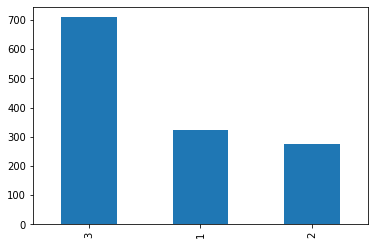

In [26]:
# se servir de matplotlib 
data['pclass'].value_counts().plot.bar()

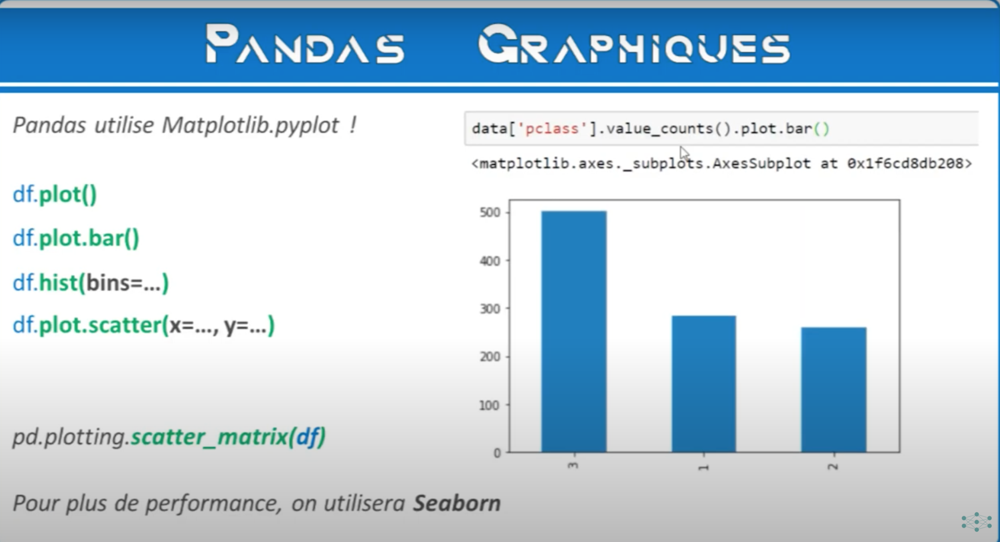

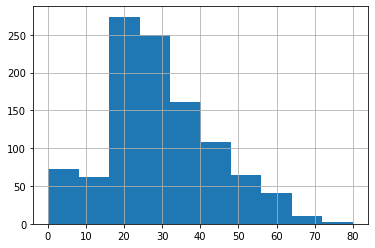

In [27]:
# histogramme en fonction de l'age
data['age'].hist()

In [34]:
# groupby pour faire une analyse de la moyenne
newDataFluent.groupby(['sex']).mean()
# 75% des femmes ont survécu et elles avaient en moyenne 28 ans
# 20% des hommes ont survécu et ils avaient en moyenne 30 ans

,pclass,survived,age
sex,,,
female,2.048969,0.752577,28.687071
male,2.300912,0.205167,30.585233


In [35]:
# groupBy en fonction du sexe et de la classe ce qui va nous faire un groupe homme et un groupe femme
# puis à l'intérieur de ces groupes un groupe par classe
newDataFluent.groupby(['sex', 'pclass']).mean()

survived        age
sex    pclass                     
female 1       0.962406  37.037594
       2       0.893204  27.499191
       3       0.473684  22.185307
male   1       0.350993  41.029250
       2       0.145570  30.815401
       3       0.169054  25.962273

pour modifier un dataframe
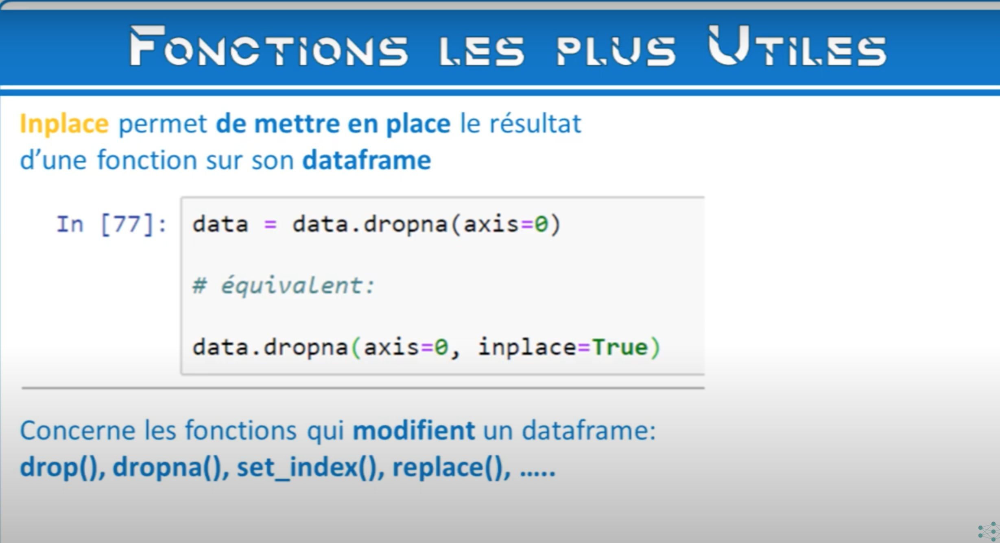

## une colonne est une série dans un dataFrame

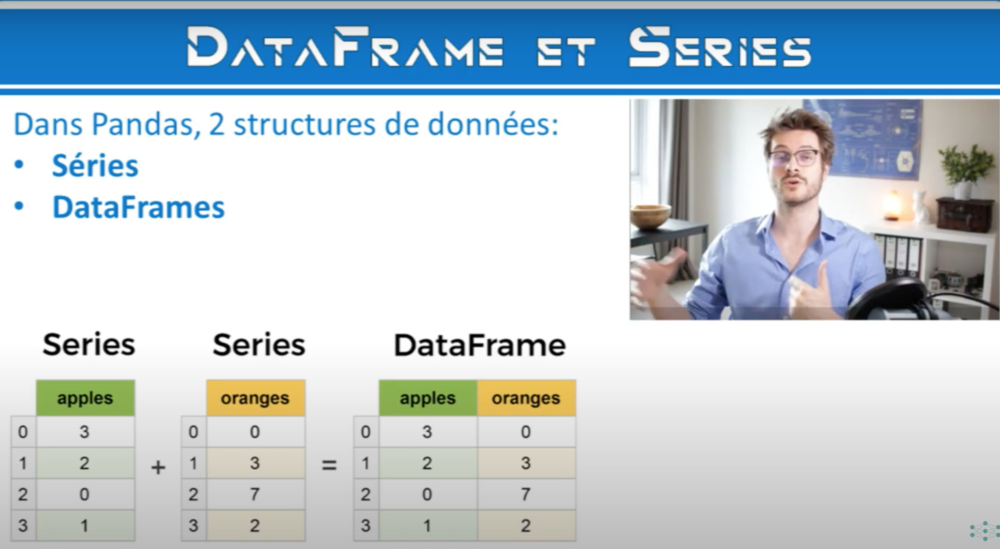

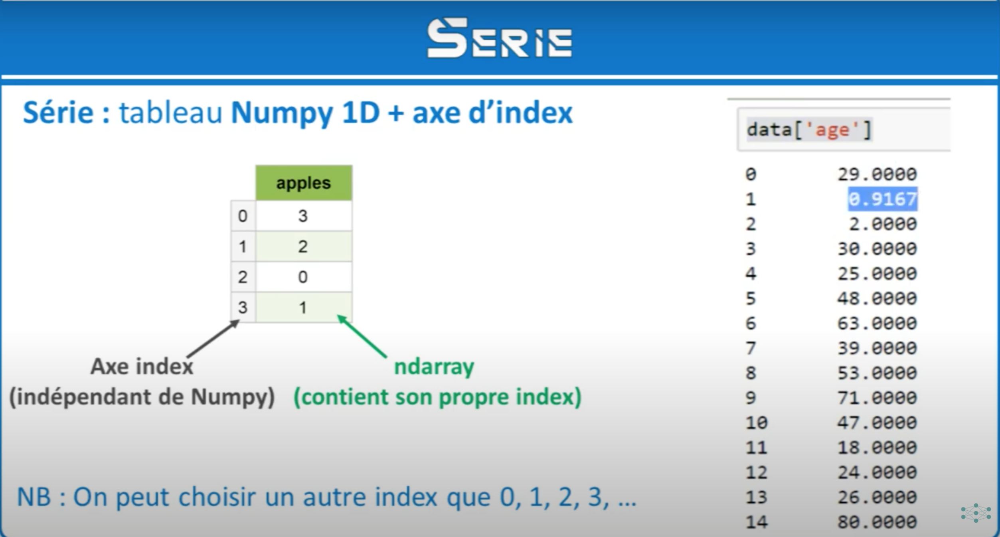

In [37]:
# modifier cet valeur d'index par le nom du passager
data['age']

0       29.0000
1        0.9167
2        2.0000
3       30.0000
4       25.0000
         ...   
1304    14.5000
1305        NaN
1306    26.5000
1307    27.0000
1308    29.0000
Name: age, Length: 1309, dtype: float64

In [42]:
data = data.set_index('name')
data['age']

name
Allen, Miss. Elisabeth Walton                      29.0000
Allison, Master. Hudson Trevor                      0.9167
Allison, Miss. Helen Loraine                        2.0000
Allison, Mr. Hudson Joshua Creighton               30.0000
Allison, Mrs. Hudson J C (Bessie Waldo Daniels)    25.0000
                                                    ...   
Zabour, Miss. Hileni                               14.5000
Zabour, Miss. Thamine                                  NaN
Zakarian, Mr. Mapriededer                          26.5000
Zakarian, Mr. Ortin                                27.0000
Zimmerman, Mr. Leo                                 29.0000
Name: age, Length: 1309, dtype: float64

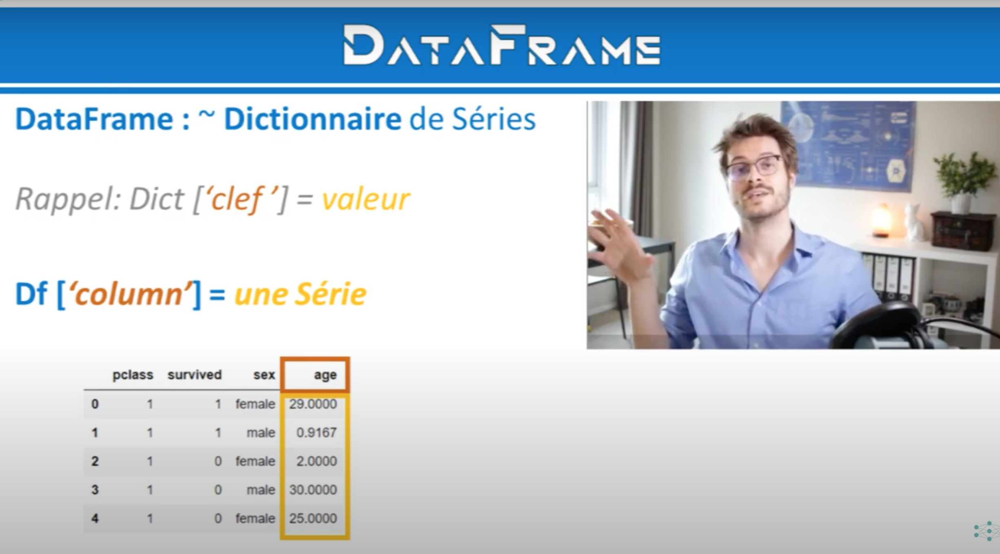

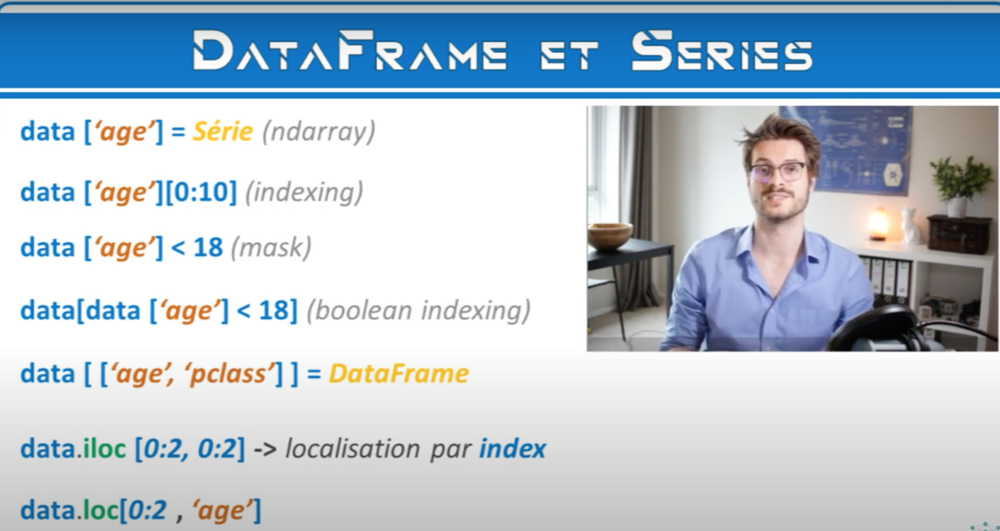

In [47]:
data['age'][0:10]

name
Allen, Miss. Elisabeth Walton                      29.0000
Allison, Master. Hudson Trevor                      0.9167
Allison, Miss. Helen Loraine                        2.0000
Allison, Mr. Hudson Joshua Creighton               30.0000
Allison, Mrs. Hudson J C (Bessie Waldo Daniels)    25.0000
Anderson, Mr. Harry                                48.0000
Andrews, Miss. Kornelia Theodosia                  63.0000
Andrews, Mr. Thomas Jr                             39.0000
Appleton, Mrs. Edward Dale (Charlotte Lamson)      53.0000
Artagaveytia, Mr. Ramon                            71.0000
Name: age, dtype: float64

In [49]:
# séléctionner uniquement les passagers mineur
data[data['age'] < 18][0:10]

,pclass,survived,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
name,,,,,,,,,,,,,
"Allison, Master. Hudson Trevor",1,1,male,0.9167,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
"Allison, Miss. Helen Loraine",1,0,female,2.0000,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
"Carrau, Mr. Jose Pedro",1,0,male,17.0000,0,0,113059,47.1000,NaN,S,NaN,NaN,"Montevideo, Uruguay"
"Carter, Master. William Thornton II",1,1,male,11.0000,1,2,113760,120.0000,B96 B98,S,4,NaN,"Bryn Mawr, PA"
"Carter, Miss. Lucile Polk",1,1,female,14.0000,1,2,113760,120.0000,B96 B98,S,4,NaN,"Bryn Mawr, PA"
"Dick, Mrs. Albert Adrian (Vera Gillespie)",1,1,female,17.0000,1,0,17474,57.0000,B20,S,3,NaN,"Calgary, AB"
"Dodge, Master. Washington",1,1,male,4.0000,0,2,33638,81.8583,A34,S,5,NaN,"San Francisco, CA"
"Hippach, Miss. Jean Gertrude",1,1,female,16.0000,0,1,111361,57.9792,B18,C,4,NaN,"Chicago, IL"
"Lines, Miss. Mary Conover",1,1,female,16.0000,0,1,PC 17592,39.4000,D28,S,9,NaN,"Paris, France"


In [50]:
# nbre de passager mineur par classe
data[data['age'] < 18]['pclass'].value_counts()

3    106
2     33
1     15
Name: pclass, dtype: int64

In [53]:
# ici on peut faire la moyenne par sexe et class des passagers en dessous de 18 ans
newDataFluent[newDataFluent['age'] < 18].groupby(['sex', 'pclass']).mean()

survived        age
sex    pclass                     
female 1       0.875000  14.125000
       2       1.000000   8.273150
       3       0.543478   8.416667
male   1       0.857143   9.845243
       2       0.733333   6.222220
       3       0.233333   9.838888

In [54]:
# fonction iloc pour faire de l'indexing comme dans numpy
data.iloc[0, 0] # revient à faire data[0, 0]

1

In [55]:
data.iloc[0:2, 0:2]

,pclass,survived
name,,
"Allen, Miss. Elisabeth Walton",1,1
"Allison, Master. Hudson Trevor",1,1


In [62]:
# fonction loc qui permet de faire pareil mais en travaillant sur les COLONNES
# on prend la colonne age et on prend sa valeur de la 0 à la 3ème
print(newDataFluent.loc[0:3, 'age'])
# même chose 
print(newDataFluent['age'][0:4])
# mais avec loc on peut utiliser plusieurs colonnes
print(newDataFluent.loc[0:3, ['age', 'pclass']])

0    29.0000
1     0.9167
2     2.0000
3    30.0000
Name: age, dtype: float64
0    29.0000
1     0.9167
2     2.0000
3    30.0000
Name: age, dtype: float64
       age  pclass
0  29.0000       1
1   0.9167       1
2   2.0000       1
3  30.0000       1


# Exercice - Feature Engineering

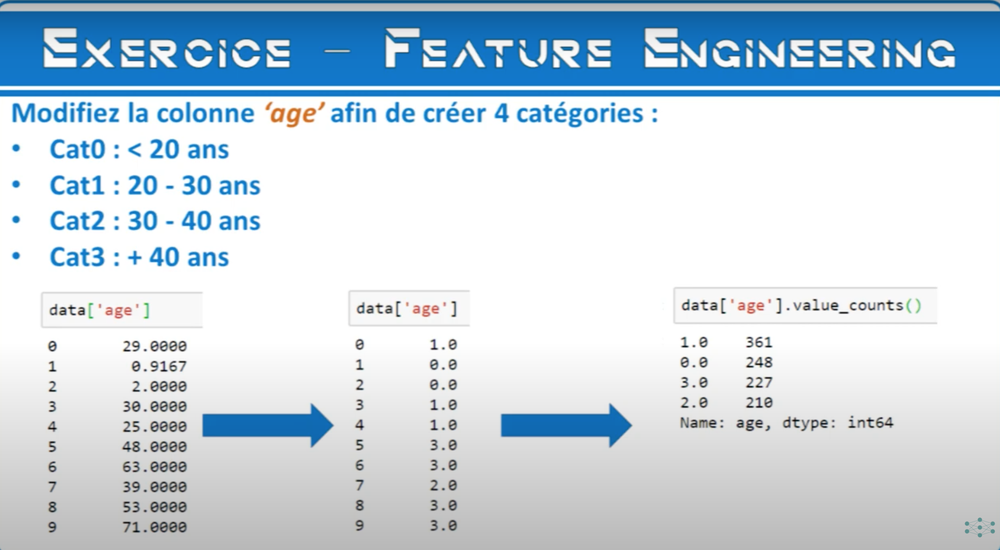

In [67]:
# reset les index après les avoir set
data = data.reset_index()
data['age']

0       29.0000
1        0.9167
2        2.0000
3       30.0000
4       25.0000
         ...   
1304    14.5000
1305        NaN
1306    26.5000
1307    27.0000
1308    29.0000
Name: age, Length: 1309, dtype: float64

In [79]:
cat0 = data['age'] = data['age'] < 20
cat1 = data['age'] = (data['age'] >= 20 & data['age'] <= 30)
cat2 = data['age'] = data['age'] > 30 & data['age'] <= 40
cat3 = data['age'] = data['age'] > 40
print(cat0)

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

# Correction

In [86]:
data = pd.read_excel('titanic3.xls')
data.loc[data['age'] <= 20, 'age'] = 0
data.loc[(data['age'] > 20) & (data['age'] <= 30), 'age'] = 1
data.loc[(data['age'] > 30) & (data['age'] <= 40), 'age'] = 2
data.loc[data['age'] > 40, 'age'] = 3
data.head()

,pclass,survived,name,sex,age,sibsp,parch,ticket,fare,cabin,embarked,boat,body,home.dest
0,1,1,"Allen, Miss. Elisabeth Walton",female,1.0,0,0,24160,211.3375,B5,S,2,NaN,"St Louis, MO"
1,1,1,"Allison, Master. Hudson Trevor",male,0.0,1,2,113781,151.5500,C22 C26,S,11,NaN,"Montreal, PQ / Chesterville, ON"
2,1,0,"Allison, Miss. Helen Loraine",female,0.0,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"
3,1,0,"Allison, Mr. Hudson Joshua Creighton",male,1.0,1,2,113781,151.5500,C22 C26,S,NaN,135.0,"Montreal, PQ / Chesterville, ON"
4,1,0,"Allison, Mrs. Hudson J C (Bessie Waldo Daniels)",female,1.0,1,2,113781,151.5500,C22 C26,S,NaN,NaN,"Montreal, PQ / Chesterville, ON"


In [87]:
data['age'].value_counts()

1.0    361
0.0    248
3.0    227
2.0    210
Name: age, dtype: int64

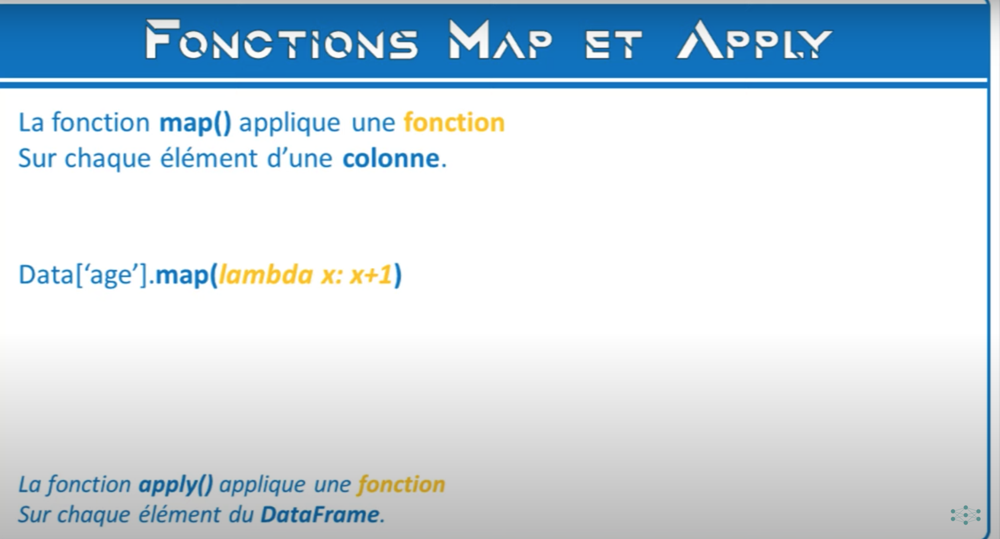

In [88]:
data['age'].map(lambda x:x+1)

0       2.0
1       1.0
2       1.0
3       2.0
4       2.0
       ... 
1304    1.0
1305    NaN
1306    2.0
1307    2.0
1308    2.0
Name: age, Length: 1309, dtype: float64

# Différence entre map et boolean indexing

### la fonction map permet de traiter les différents éléments de la colonne age ici les uns après les autres
### alors que le boolean indexing lui traite tout le tableau d'un coup


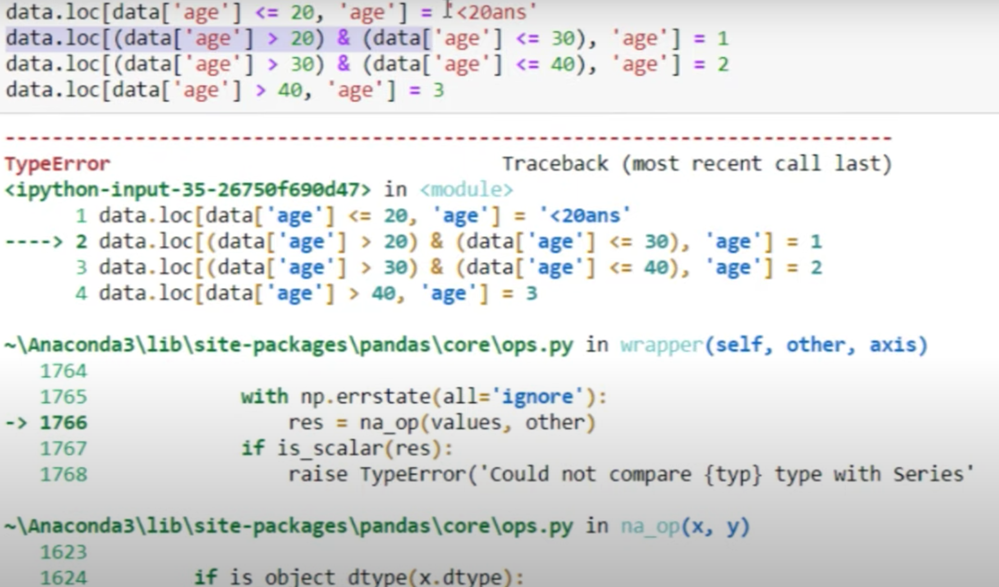

In [92]:
def category_ages(age):
    if age <= 20:
        return '<20 ans'
    elif (age> 20) & (age <= 30):
        return '20-30 ans'
    elif(age> 30) & (age <= 40):
        return '30-40 ans'
    else:
        return '+40 ans'

data['age'].map(lambda age:category_ages(age))
# équivaut à
data['age'].map(category_ages)

0       <20 ans
1       <20 ans
2       <20 ans
3       <20 ans
4       <20 ans
         ...   
1304    <20 ans
1305    +40 ans
1306    <20 ans
1307    <20 ans
1308    <20 ans
Name: age, Length: 1309, dtype: object

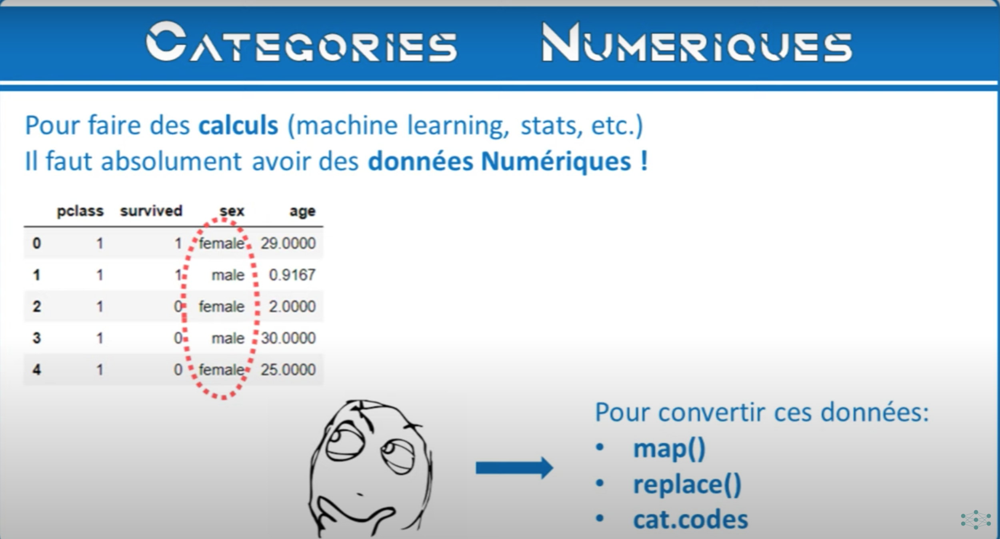

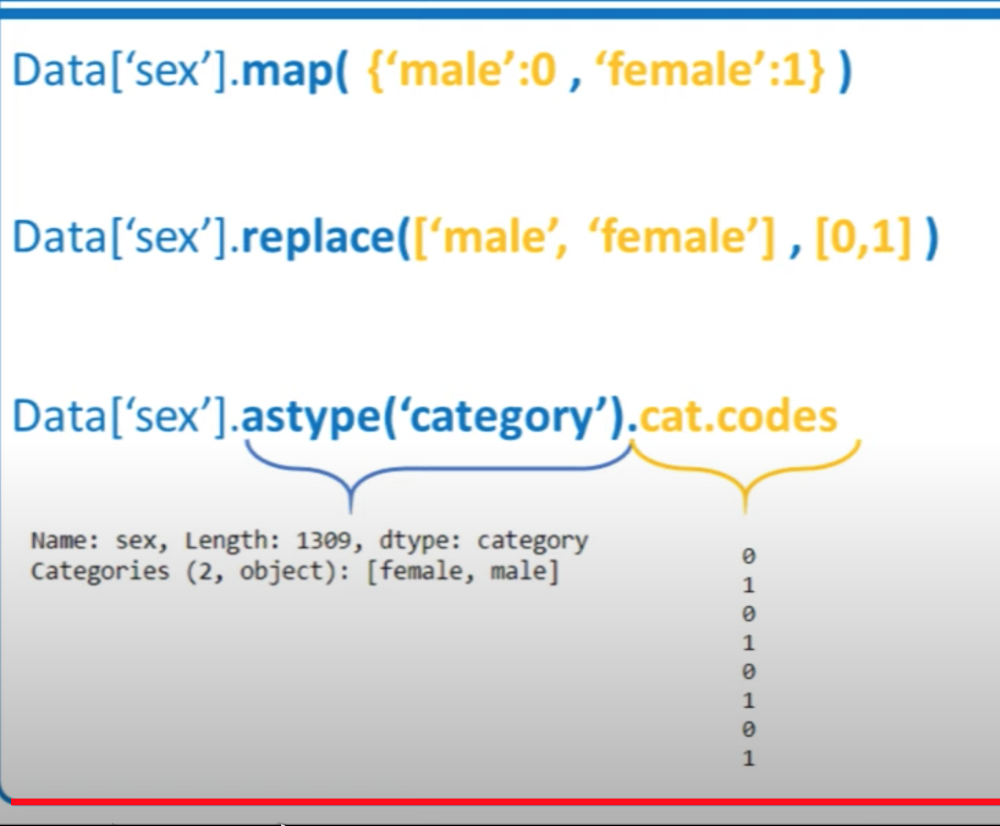

In [93]:
data['sex'].map({'male':0, 'female':1})

0       1
1       0
2       1
3       0
4       1
       ..
1304    1
1305    1
1306    0
1307    0
1308    0
Name: sex, Length: 1309, dtype: int64

In [96]:
data['sex'].replace(['male', 'female'], [0,1])

0       1
1       0
2       1
3       0
4       1
       ..
1304    1
1305    1
1306    0
1307    0
1308    0
Name: sex, Length: 1309, dtype: int64

In [97]:
# dans le cas où on a beacoup de catégories c'est très utile
data['sex'].astype('category').cat.codes

0       0
1       1
2       0
3       1
4       0
       ..
1304    0
1305    0
1306    1
1307    1
1308    1
Length: 1309, dtype: int8